In [ ]:
#to delete

import shutil
import os

# Specify the path to the folder you want to delete
folder_path = '/content/drive/MyDrive/paddy pest detector/output'  # Replace with the actual path to your folder

# Check if the folder exists before attempting to delete it
if os.path.exists(folder_path):
    # Delete the folder and its contents
    shutil.rmtree(folder_path)
    print(f"Folder '{folder_path}' and its contents have been deleted.")
else:
    print(f"Folder '{folder_path}' does not exist.")

Folder '/content/drive/MyDrive/paddy pest detector/output' and its contents have been deleted.


In [ ]:
#to unzip

import zipfile
import os

# path to the ZIP file and the destination folder
zip_file_path = '/content/drive/MyDrive/images with annotations.zip'
destination_folder = '/content/drive/MyDrive/paddy pest detector'

# Create the destination folder
os.makedirs(destination_folder, exist_ok=True)

# Open the ZIP file in read mode
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Extract all the contents of the ZIP file into the destination folder
    zip_ref.extractall(destination_folder)

print(f"Files extracted to: {destination_folder}")

Files extracted to: /content/drive/MyDrive/paddy pest detector


In [ ]:
# to check all images found

import os
import json

# Paths
image_dir = "/content/drive/MyDrive/paddy pest detector/images with annotations/images/"
coco_json_path = "/content/drive/MyDrive/paddy pest detector/images with annotations/annotations/instances_default.json"

# Load COCO annotations
with open(coco_json_path, "r") as f:
    coco_data = json.load(f)

# Check image files
missing_images = []
for img in coco_data["images"]:
    file_path = os.path.join(image_dir, img["file_name"])
    if not os.path.exists(file_path):
        missing_images.append(img["file_name"])

if missing_images:
    print("Missing images:", missing_images)
else:
    print("All images found.")


All images found.


In [ ]:
# delete images that are not in the annotation
import os
import json  # Use this if the annotation file is JSON
import shutil

def delete_unreferenced_images(image_folder, annotation_file):
    """
    Deletes images in the image folder that are not listed in the annotation file.

    :param image_folder: Path to the folder containing images.
    :param annotation_file: Path to the annotation file (JSON format in this example).
    """
    # Step 1: Load the annotation file (adjust for your annotation format)
    with open(annotation_file, 'r') as file:
        annotations = json.load(file)  # Assumes JSON file with image filenames listed
        # Extract the filenames from the list of dictionaries
        referenced_images = set(img_info['file_name'] for img_info in annotations['images'])

    # Step 2: Get all image filenames in the folder
    all_images = set(os.listdir(image_folder))

    # Step 3: Find unreferenced images
    unreferenced_images = all_images - referenced_images

    # Step 4: Delete unreferenced images
    for image_name in unreferenced_images:
        image_path = os.path.join(image_folder, image_name)
        try:
            if os.path.isfile(image_path):  # Ensure it's a file
                os.remove(image_path)
                print(f"Deleted: {image_name}")
        except Exception as e:
            print(f"Error deleting {image_name}: {e}")

# Example usage
image_folder_path = '/content/drive/MyDrive/paddy pest detector/images with annotations/images'
annotation_file_path = '/content/drive/MyDrive/paddy pest detector/images with annotations/annotations/instances_default.json'

delete_unreferenced_images(image_folder_path, annotation_file_path)

Deleted: 00000531.jpg
Deleted: 00000663.jpg
Deleted: 00000121.jpg
Deleted: 00000722.png
Deleted: 00000371.jpg
Deleted: 00000504 (2).jpg
Deleted: 00000329 (2).jpg
Deleted: 00000453.jpg
Deleted: 00000175.jpg
Deleted: 00000709.jpg
Deleted: 00000690.jpg
Deleted: 00000079.jpg
Deleted: 00000347.jpg
Deleted: 00000130.jpg
Deleted: 00000165.jpg
Deleted: 00000249 (2).jpg
Deleted: 00000609.jpg
Deleted: 00000691.jpg
Deleted: 00000322.jpg
Deleted: 00000254.jpg
Deleted: 00000694.jpg
Deleted: 00000603.jpg
Deleted: 00000661.jpg
Deleted: 00000354.jpg
Deleted: 00000191.jpg
Deleted: 00000345.jpg
Deleted: 00000251.jpg
Deleted: 00000532.jpg
Deleted: 00000248.jpg
Deleted: 00000498.jpg
Deleted: 00000640.jpg
Deleted: 00000713.jpg
Deleted: 00000037 (2).jpg
Deleted: 00000349.jpg
Deleted: 00000206.jpg
Deleted: 00000217.jpg
Deleted: 00000614.jpg
Deleted: 00000032.jpg
Deleted: 00000408.jpg
Deleted: 00000285.jpg
Deleted: 00000173.jpg
Deleted: 00000720.jpg
Deleted: 00000083.jpg
Deleted: 00000540.jpg
Deleted: 0000054

In [ ]:
# delete all duplicate images

import os
import hashlib
import json
from shutil import move

def hash_image(file_path):
    """Generate MD5 hash for an image file."""
    with open(file_path, 'rb') as f:
        return hashlib.md5(f.read()).hexdigest()

def find_and_remove_duplicates(image_dir, coco_file_path, output_dir):
    """
    Find and remove duplicate images and update the COCO-format annotations.

    Args:
        image_dir (str): Path to the directory containing images.
        coco_file_path (str): Path to the COCO-format JSON file.
        output_dir (str): Directory to save updated files and JSON.
    """
    # Load COCO JSON
    with open(coco_file_path, 'r') as f:
        coco_data = json.load(f)

    # Map to store hashes and keep track of duplicates
    image_hashes = {}
    duplicate_image_ids = set()

    # Ensure the output directory exists
    os.makedirs(output_dir, exist_ok=True)

    # Find duplicates
    print("Identifying duplicates...")
    for image_info in coco_data['images']:
        image_id = image_info['id']
        file_name = image_info['file_name']
        file_path = os.path.join(image_dir, file_name)

        if not os.path.exists(file_path):
            print(f"Warning: {file_path} does not exist. Skipping.")
            continue

        file_hash = hash_image(file_path)

        if file_hash in image_hashes:
            duplicate_image_ids.add(image_id)
            os.remove(file_path)  # Remove duplicate image
            print(f"Removed duplicate: {file_name}")
        else:
            image_hashes[file_hash] = image_id

    # Remove duplicates from JSON
    print("Updating COCO annotations...")
    coco_data['images'] = [
        image_info for image_info in coco_data['images']
        if image_info['id'] not in duplicate_image_ids
    ]
    coco_data['annotations'] = [
        annotation for annotation in coco_data['annotations']
        if annotation['image_id'] not in duplicate_image_ids
    ]

    # Save updated JSON
    updated_coco_file_path = os.path.join(output_dir, 'updated_coco_annotations.json')
    with open(updated_coco_file_path, 'w') as f:
        json.dump(coco_data, f, indent=4)

    print(f"Updated COCO annotations saved to {updated_coco_file_path}")

# Usage Example
image_folder = "/content/drive/MyDrive/paddy pest detector/images with annotations/images"
coco_annotation_file = "/content/drive/MyDrive/paddy pest detector/images with annotations/annotations/instances_default.json"
output_directory = "/content/drive/MyDrive/paddy pest detector/images with annotations"

find_and_remove_duplicates(image_folder, coco_annotation_file, output_directory)


Identifying duplicates...
Removed duplicate: 00000048 (2).jpg
Removed duplicate: 00000050 (2).jpg
Removed duplicate: 00000053.jpg
Removed duplicate: 00000056.jpg
Removed duplicate: 00000057.jpg
Removed duplicate: 00000062 (2).jpg
Removed duplicate: 00000070.jpg
Removed duplicate: 00000075.jpg
Removed duplicate: 00000094.jpg
Removed duplicate: 00000098 (2).jpg
Removed duplicate: 00000116.jpg
Removed duplicate: 00000119.jpg
Removed duplicate: 00000131.jpg
Removed duplicate: 00000136 (2).jpg
Removed duplicate: 00000138.jpg
Removed duplicate: 00000140 (2).jpg
Removed duplicate: 00000141.jpg
Removed duplicate: 00000142.jpg
Removed duplicate: 00000148.jpg
Removed duplicate: 00000166 (2).jpg
Removed duplicate: 00000177.jpg
Removed duplicate: 00000180.jpg
Removed duplicate: 00000186.jpg
Removed duplicate: 00000190.jpg
Removed duplicate: 00000194.jpg
Removed duplicate: 00000196.jpg
Removed duplicate: 00000200.jpg
Removed duplicate: 00000207.jpg
Removed duplicate: 00000219.jpg
Removed duplicate:

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install -U 'git+https://github.com/facebookresearch/detectron2.git'


  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-0welzkro
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-0welzkro
  Resolved https://github.com/facebookresearch/detectron2.git to commit 9604f5995cc628619f0e4fd913453b4d7d61db3f
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 4.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.2/79.2 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 10.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 47.0 MB/s eta 0:00:00
  Created wheel for detectron2: filename=detectron2-0.6-cp3

In [ ]:
import os
import random
import cv2
import numpy as np
import matplotlib.pyplot as plt
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_train_loader, build_detection_test_loader
from detectron2.data.datasets import register_coco_instances
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.engine import DefaultTrainer, DefaultPredictor, hooks
from detectron2.config import get_cfg
from detectron2.model_zoo import get_checkpoint_url, get_config_file
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import transforms as T
from google.colab.patches import cv2_imshow
import json
import torch
import shutil
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module="detectron2")

In [ ]:
def register_dataset(dataset_name, image_dir, annotation_path):
    """Register the COCO dataset."""
    DatasetCatalog.clear()  # Clear existing datasets to avoid conflicts
    register_coco_instances(dataset_name, {}, annotation_path, image_dir)
    MetadataCatalog.get(dataset_name).set(thing_classes=["pest"])

In [ ]:
def split_dataset(dataset_name, image_dir, output_dir, train_ratio=0.8, val_ratio=0.1):
    os.makedirs(output_dir, exist_ok=True)

    dataset_dicts = DatasetCatalog.get(dataset_name)
    random.shuffle(dataset_dicts)

    # Separate pest and non-pest images
    pest_images = []
    non_pest_images = []
    for data in dataset_dicts:
        if "annotations" in data and any("segmentation" in ann for ann in data["annotations"]):
            pest_images.append(data)
        else:
            non_pest_images.append(data)

    # Balance the dataset
    min_len = min(len(pest_images), len(non_pest_images))
    pest_images = pest_images[:min_len]
    non_pest_images = non_pest_images[:min_len]

    # Combine and shuffle
    balanced_dataset = pest_images + non_pest_images
    random.shuffle(balanced_dataset)

    # Calculate split sizes
    num_train = int(len(balanced_dataset) * train_ratio)
    num_val = int(len(balanced_dataset) * val_ratio)

    # Create separate lists for train, val, and test
    train_dicts = balanced_dataset[:num_train]
    val_dicts = balanced_dataset[num_train:num_train + num_val]
    test_dicts = balanced_dataset[num_train + num_val:]

    # Create directories for the splits
    train_dir = os.path.join(output_dir, "train_images")
    val_dir = os.path.join(output_dir, "val_images")
    test_dir = os.path.join(output_dir, "test_images")

    os.makedirs(train_dir, exist_ok=True)
    os.makedirs(val_dir, exist_ok=True)
    os.makedirs(test_dir, exist_ok=True)

    def organize_images(data, target_dir):
      for item in data:
        # Get the filename from the full path
        src_path = os.path.join(image_dir, item["file_name"])

        # Extract the filename
        filename = os.path.basename(src_path)

        # Destination path in the target directory
        dst_path = os.path.join(target_dir, filename)

        if not os.path.exists(dst_path):
            shutil.copy(src_path, dst_path)  # Copy the file

        # Update the file_name to only the filename, no path
        item["file_name"] = filename

    # Save the splits as separate JSON files
    def save_coco_json(file_path, data):
        with open(file_path, "w") as f:
            json.dump(data, f, indent=4)

    save_coco_json(os.path.join(output_dir, "train.json"), train_dicts)
    save_coco_json(os.path.join(output_dir, "val.json"), val_dicts)
    save_coco_json(os.path.join(output_dir, "test.json"), test_dicts)

    DatasetCatalog.clear()  # Clear before registering

    # Register the datasets with Detectron2
    DatasetCatalog.register("paddy_train", lambda: train_dicts)
    DatasetCatalog.register("paddy_val", lambda: val_dicts)
    DatasetCatalog.register("paddy_test", lambda: test_dicts)

    MetadataCatalog.get("paddy_train").set(thing_classes=["pest"])
    MetadataCatalog.get("paddy_val").set(thing_classes=["pest"])
    MetadataCatalog.get("paddy_test").set(thing_classes=["pest"])

In [ ]:
def update_file_paths_to_filenames_only(json_file_path):
    """Updates 'file_name' in JSON to only filenames (removes paths)."""
    with open(json_file_path, 'r+') as f:
        data = json.load(f)
        for image_info in data:  # Directly iterate through the list of image dictionaries
            # Extract only the filename from the 'file_name' field
            filename = os.path.basename(image_info['file_name'])

            # Update file_name
            image_info['file_name'] = filename

        # Reset file pointer to the beginning and write the updated data
        f.seek(0)
        json.dump(data, f, indent=4)
        f.truncate()  # Important: Resize the file to the new content


In [ ]:
def apply_augmentations_with_masks_and_boxes(dataset_dicts, metadata, output_dir, num_samples=3):
    augmentations = [
        T.ResizeShortestEdge(short_edge_length=(640, 800), max_size=1333, sample_style="choice"),
        T.RandomFlip(prob=0.5, horizontal=True, vertical=False),
        T.RandomBrightness(0.8, 1.2),
        T.RandomContrast(0.8, 1.2),
    ]

    for data in random.sample(dataset_dicts, num_samples):
        # The original output_dir was changed to image_dir in 'if __name__ == "__main__":' part
        # as dataset dicts are referencing original image locations
        image_path = os.path.join(image_dir, data["file_name"])

        img = cv2.imread(image_path)

        # Check if the image was loaded correctly
        if img is None:
            print(f"Error: Could not read image at path: {image_path}")
            continue  # Skip to the next image if loading failed

        aug_input = T.AugInput(img)
        transforms = T.AugmentationList(augmentations)(aug_input)
        img_aug = aug_input.image

        # Apply transforms to annotations if they exist
        if "annotations" in data:
            for ann in data["annotations"]:
                if "segmentation" in ann:
                    new_segmentation = []
                    for poly in ann["segmentation"]:
                        poly_np = np.array(poly).reshape(-1, 2)
                        transformed_poly = transforms.apply_coords(poly_np)
                        new_segmentation.append(transformed_poly.flatten().tolist())
                    ann["segmentation"] = new_segmentation

                    # Recalculate bounding box
                    all_x = [p[0] for p in transformed_poly]
                    all_y = [p[1] for p in transformed_poly]
                    x_min, y_min = min(all_x), min(all_y)
                    x_max, y_max = max(all_x), max(all_y)
                    ann["bbox"] = [x_min, y_min, x_max - x_min, y_max - y_min]

        visualizer = Visualizer(img_aug[:, :, ::-1], metadata=metadata, scale=0.5)
        vis = visualizer.draw_dataset_dict(data)
        plt.figure(figsize=(12, 8))
        plt.imshow(vis.get_image()[:, :, ::-1])
        plt.axis("off")
        plt.show()

In [ ]:
class MyTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name):
        return COCOEvaluator(dataset_name, cfg, False, output_dir=cfg.OUTPUT_DIR)

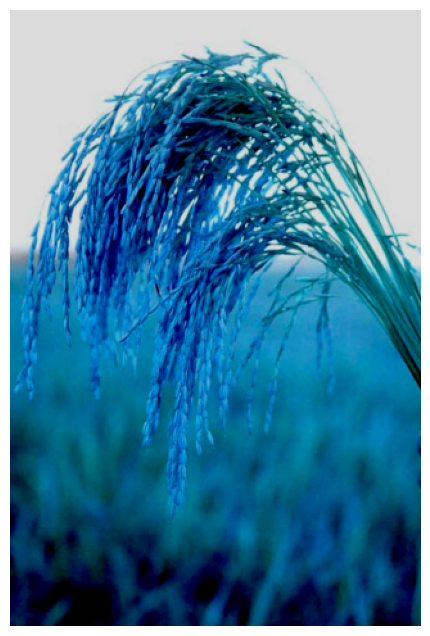

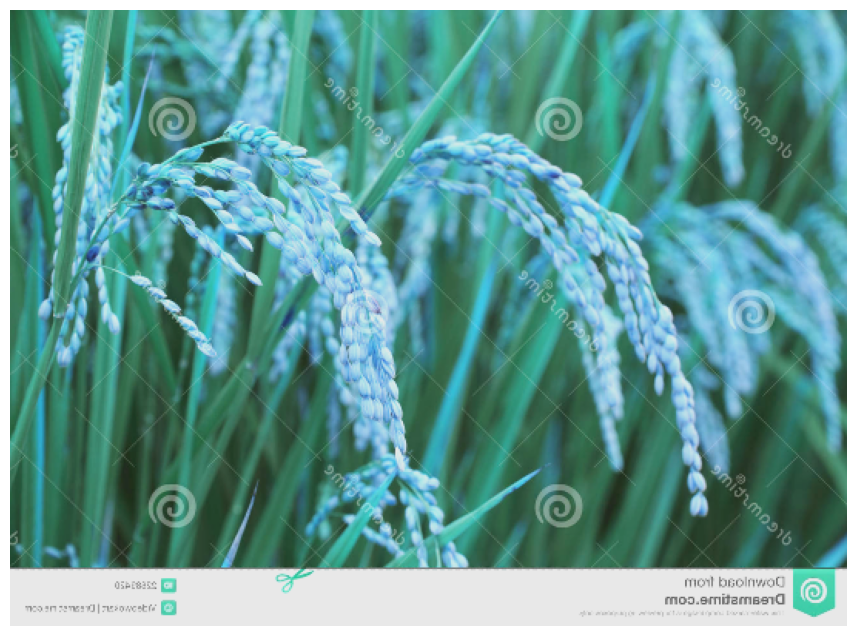

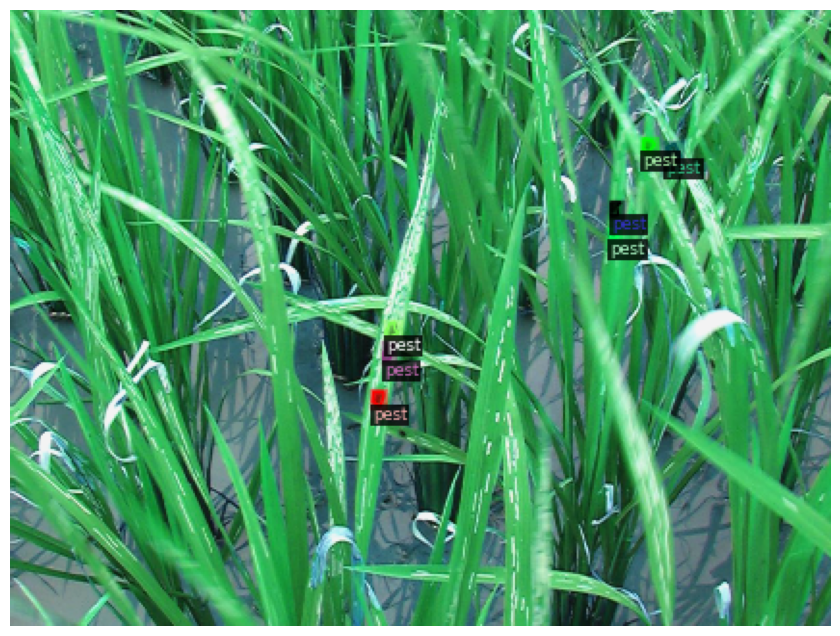

In [ ]:
if __name__ == "__main__":
    dataset_name = "paddy_dataset"
    image_dir = "/content/drive/MyDrive/paddy pest detector/images with annotations/images"
    annotation_path = "/content/drive/MyDrive/paddy pest detector/images with annotations/updated_coco_annotations.json"
    output_dir = "/content/drive/MyDrive/paddy pest detector/output"

     # 1. Register the dataset
    register_dataset(dataset_name, image_dir, annotation_path)

    # 2. Split the dataset into train, val, and test
    split_dataset(dataset_name, image_dir, output_dir)

    train_dicts = DatasetCatalog.get("paddy_train")
    val_dicts = DatasetCatalog.get("paddy_val")
    test_dicts = DatasetCatalog.get("paddy_test")


    update_file_paths_to_filenames_only(os.path.join(output_dir, "train.json"))
    update_file_paths_to_filenames_only(os.path.join(output_dir, "val.json"))
    update_file_paths_to_filenames_only(os.path.join(output_dir, "test.json"))

    all_image_ids = [d["image_id"] for d in train_dicts + val_dicts + test_dicts]
    assert len(all_image_ids) == len(set(all_image_ids)), "Duplicate image IDs found across splits!"

    # 3. Augment only the training set
    metadata = MetadataCatalog.get("paddy_train")  # Get metadata for training set
    train_dataset_dicts = DatasetCatalog.get("paddy_train")  # Get training dataset
    apply_augmentations_with_masks_and_boxes(train_dataset_dicts, metadata, image_dir)  # Apply augmentations

In [ ]:
    cfg = get_cfg()
    cfg.merge_from_file(get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
    cfg.DATASETS.TRAIN = ("paddy_train",)
    cfg.DATASETS.TEST = ("paddy_val",)
    cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

    cfg.SOLVER.BASE_LR = 0.00025
    cfg.SOLVER.IMS_PER_BATCH = 2
    cfg.SOLVER.MAX_ITER = 5000

    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    cfg.MODEL.ROI_HEADS.NMS_THRESH_TEST = 0.3
    cfg.MODEL.ROI_HEADS.PRE_NMS_TOPK_TEST = 1000
    cfg.TEST.EVAL_PERIOD = 500
    cfg.MODEL.ROI_HEADS.CLS_WEIGHT = 10.0  # Higher value for minority class (pests)
    cfg.MODEL.ROI_HEADS.BBOX_WEIGHT = 1.0

    # Ensure enough GPU memory is available
    torch.cuda.empty_cache()

    trainer = MyTrainer(cfg)
    trainer.resume_or_load(resume=False)
    trainer.train()

    evaluator = COCOEvaluator("paddy_test", cfg, False, output_dir="./output")
    test_loader = build_detection_test_loader(cfg, "paddy_test")
    print(inference_on_dataset(trainer.model, test_loader, evaluator))

[01/20 16:41:06 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(
R-50.pkl: 102MB [00:00, 145MB/s]                           

[01/20 16:41:07 d2.checkpoint.c2_model_loading]: Renaming Caffe2 weights ......


[01/20 16:41:07 d2.checkpoint.c2_model_loading]: Following weights matched with submodule backbone.bottom_up - Total num: 54


backbone.fpn_lateral2.{bias, weight}
backbone.fpn_lateral3.{bias, weight}
backbone.fpn_lateral4.{bias, weight}
backbone.fpn_lateral5.{bias, weight}
backbone.fpn_output2.{bias, weight}
backbone.fpn_output3.{bias, weight}
backbone.fpn_output4.{bias, weight}
backbone.fpn_output5.{bias, weight}
proposal_generator.rpn_head.anchor_deltas.{bias, weight}
proposal_generator.rpn_head.conv.{bias, weight}
proposal_generator.rpn_head.objectness_logits.{bias, weight}
roi_heads.box_head.fc1.{bias, weight}
roi_heads.box_head.fc2.{bias, weight}
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.deconv.{bias, weight}
roi_heads.mask_head.mask_fcn1.{bias, weight}
roi_heads.mask_head.mask_fcn2.{bias, weight}
roi_heads.mask_head.mask_fcn3.{bias, weight}
roi_heads.mask_head.mask_fcn4.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}
  fc1000.{bias, weight}
  stem.conv1.bias


[01/20 16:41:07 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:534: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3595.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[01/20 16:41:23 d2.utils.events]:  eta: 0:35:43  iter: 19  total_loss: 1.946  loss_cls: 0.5335  loss_box_reg: 0.001609  loss_mask: 0.6936  loss_rpn_cls: 0.6837  loss_rpn_loc: 0.01593    time: 0.5385  last_time: 0.3545  data_time: 0.1708  last_data_time: 0.0017   lr: 4.9953e-06  max_mem: 2577M
[01/20 16:41:40 d2.utils.events]:  eta: 0:38:56  iter: 39  total_loss: 1.689  loss_cls: 0.2486  loss_box_reg: 0.002191  loss_mask: 0.6933  loss_rpn_cls: 0.6777  loss_rpn_loc: 0.04073    time: 0.5792  last_time: 0.3697  data_time: 0.1124  last_data_time: 0.0021   lr: 9.9902e-06  max_mem: 2667M
[01/20 16:41:49 d2.utils.events]:  eta: 0:36:59  iter: 59  total_loss: 1.482  loss_cls: 0.09566  loss_box_reg: 0.00132  loss_mask: 0.6931  loss_rpn_cls: 0.6612  loss_rpn_loc: 0.01748    time: 0.5400  last_time: 0.4552  data_time: 0.0531  last_data_time: 0.0073   lr: 1.4985e-05  max_mem: 2667M
[01/20 16:41:58 d2.utils.events]:  eta: 0:36:51  iter: 79  total_loss: 1.438  loss_cls: 0.07358  loss_box_reg: 0.01956

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 16:45:21 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.1488 s/iter. Inference: 0.1012 s/iter. Eval: 0.0030 s/iter. Total: 0.2531 s/iter. ETA=0:00:02
[01/20 16:45:24 d2.evaluation.evaluator]: Total inference time: 0:00:04.660162 (0.274127 s / iter per device, on 1 devices)
[01/20 16:45:24 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.103642 s / iter per device, on 1 devices)
[01/20 16:45:24 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 16:45:24 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 16:45:24 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 16:45:24 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 16:45:24 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.01 seconds.
[01/20 16:45:24 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 16:49:29 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0044 s/iter. Inference: 0.1287 s/iter. Eval: 0.0080 s/iter. Total: 0.1411 s/iter. ETA=0:00:01
[01/20 16:49:30 d2.evaluation.evaluator]: Total inference time: 0:00:02.309250 (0.135838 s / iter per device, on 1 devices)
[01/20 16:49:30 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.116096 s / iter per device, on 1 devices)
[01/20 16:49:30 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 16:49:30 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 16:49:30 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 16:49:30 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 16:49:30 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[01/20 16:49:30 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 16:53:31 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0017 s/iter. Inference: 0.1046 s/iter. Eval: 0.0021 s/iter. Total: 0.1085 s/iter. ETA=0:00:01
[01/20 16:53:33 d2.evaluation.evaluator]: Total inference time: 0:00:01.937231 (0.113955 s / iter per device, on 1 devices)
[01/20 16:53:33 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.103832 s / iter per device, on 1 devices)
[01/20 16:53:33 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 16:53:33 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 16:53:33 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 16:53:33 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 16:53:33 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[01/20 16:53:33 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 16:57:36 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0012 s/iter. Inference: 0.1051 s/iter. Eval: 0.0038 s/iter. Total: 0.1102 s/iter. ETA=0:00:01
[01/20 16:57:37 d2.evaluation.evaluator]: Total inference time: 0:00:01.947031 (0.114531 s / iter per device, on 1 devices)
[01/20 16:57:37 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.103708 s / iter per device, on 1 devices)
[01/20 16:57:37 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 16:57:37 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 16:57:37 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 16:57:37 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 16:57:37 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.01 seconds.
[01/20 16:57:37 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 17:01:42 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0018 s/iter. Inference: 0.1062 s/iter. Eval: 0.0020 s/iter. Total: 0.1100 s/iter. ETA=0:00:01
[01/20 17:01:43 d2.evaluation.evaluator]: Total inference time: 0:00:01.946653 (0.114509 s / iter per device, on 1 devices)
[01/20 17:01:43 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.104095 s / iter per device, on 1 devices)
[01/20 17:01:43 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 17:01:43 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 17:01:43 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 17:01:43 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 17:01:43 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.01 seconds.
[01/20 17:01:43 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 17:05:46 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0079 s/iter. Inference: 0.1224 s/iter. Eval: 0.0073 s/iter. Total: 0.1376 s/iter. ETA=0:00:01
[01/20 17:05:47 d2.evaluation.evaluator]: Total inference time: 0:00:02.289979 (0.134705 s / iter per device, on 1 devices)
[01/20 17:05:47 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.112277 s / iter per device, on 1 devices)
[01/20 17:05:47 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 17:05:47 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 17:05:47 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 17:05:47 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 17:05:47 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.01 seconds.
[01/20 17:05:47 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 17:09:52 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0012 s/iter. Inference: 0.1042 s/iter. Eval: 0.0021 s/iter. Total: 0.1075 s/iter. ETA=0:00:01
[01/20 17:09:54 d2.evaluation.evaluator]: Total inference time: 0:00:01.987021 (0.116884 s / iter per device, on 1 devices)
[01/20 17:09:54 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.104208 s / iter per device, on 1 devices)
[01/20 17:09:54 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 17:09:54 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 17:09:54 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 17:09:54 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 17:09:54 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[01/20 17:09:54 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 17:13:58 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0012 s/iter. Inference: 0.1043 s/iter. Eval: 0.0020 s/iter. Total: 0.1076 s/iter. ETA=0:00:01
[01/20 17:13:59 d2.evaluation.evaluator]: Total inference time: 0:00:01.971948 (0.115997 s / iter per device, on 1 devices)
[01/20 17:13:59 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.105191 s / iter per device, on 1 devices)
[01/20 17:13:59 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 17:13:59 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 17:13:59 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 17:13:59 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 17:13:59 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[01/20 17:13:59 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 17:18:04 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0011 s/iter. Inference: 0.1051 s/iter. Eval: 0.0022 s/iter. Total: 0.1084 s/iter. ETA=0:00:01
[01/20 17:18:05 d2.evaluation.evaluator]: Total inference time: 0:00:01.948996 (0.114647 s / iter per device, on 1 devices)
[01/20 17:18:05 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.104600 s / iter per device, on 1 devices)
[01/20 17:18:05 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 17:18:05 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 17:18:05 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 17:18:05 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 17:18:05 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[01/20 17:18:05 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 17:22:17 d2.evaluation.evaluator]: Inference done 11/22. Dataloading: 0.0019 s/iter. Inference: 0.1087 s/iter. Eval: 0.0021 s/iter. Total: 0.1128 s/iter. ETA=0:00:01
[01/20 17:22:18 d2.evaluation.evaluator]: Total inference time: 0:00:01.972073 (0.116004 s / iter per device, on 1 devices)
[01/20 17:22:18 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.105444 s / iter per device, on 1 devices)
[01/20 17:22:18 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 17:22:18 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 17:22:18 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 17:22:18 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 17:22:18 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.00 seconds.
[01/20 17:22:18 d2.evaluation.

/usr/local/lib/python3.11/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


[01/20 17:22:22 d2.evaluation.evaluator]: Inference done 11/23. Dataloading: 0.0937 s/iter. Inference: 0.1179 s/iter. Eval: 0.0033 s/iter. Total: 0.2149 s/iter. ETA=0:00:02
[01/20 17:22:26 d2.evaluation.evaluator]: Total inference time: 0:00:05.409262 (0.300515 s / iter per device, on 1 devices)
[01/20 17:22:26 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.107270 s / iter per device, on 1 devices)
[01/20 17:22:26 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[01/20 17:22:26 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[01/20 17:22:26 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[01/20 17:22:26 d2.evaluation.fast_eval_api]: Evaluate annotation type *bbox*
[01/20 17:22:26 d2.evaluation.fast_eval_api]: COCOeval_opt.evaluate() finished in 0.01 seconds.
[01/20 17:22:26 d2.evaluation.

[01/20 17:28:52 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

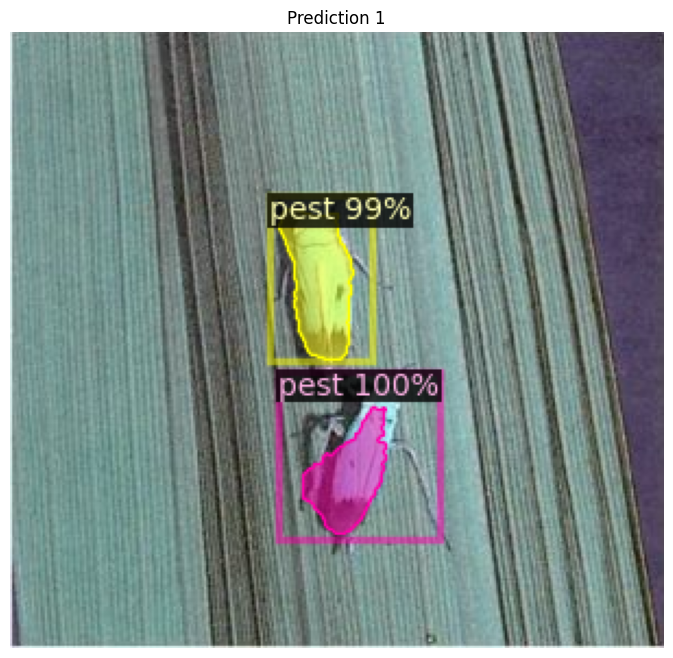

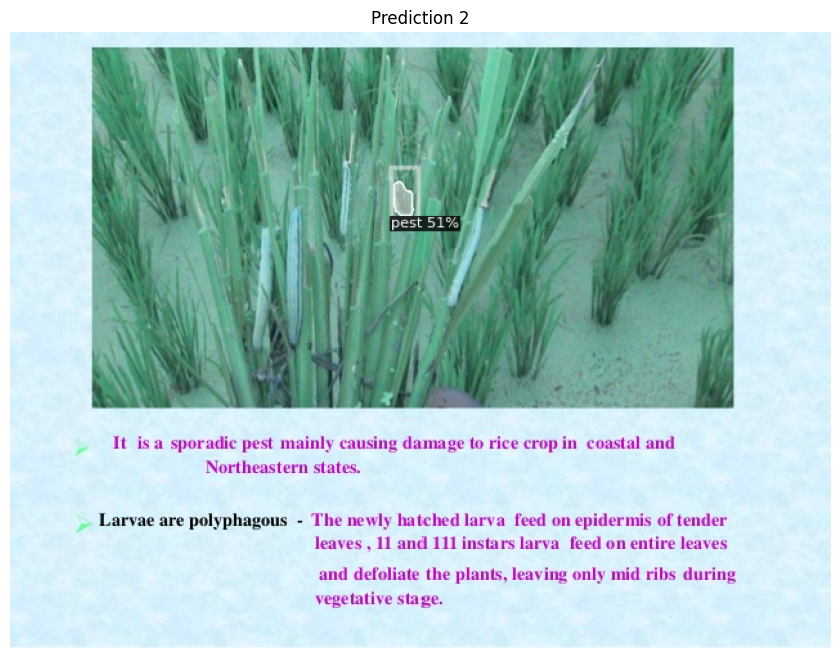

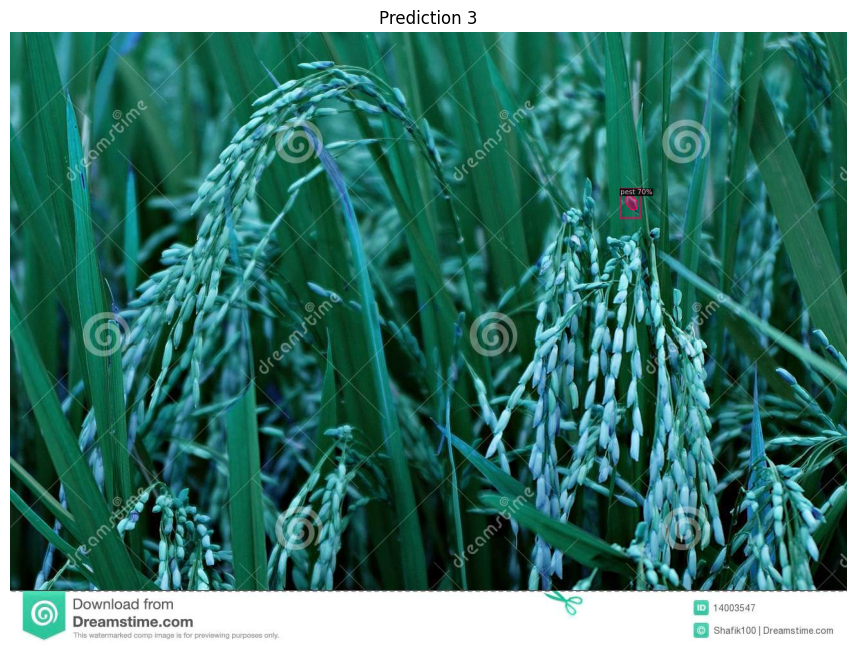

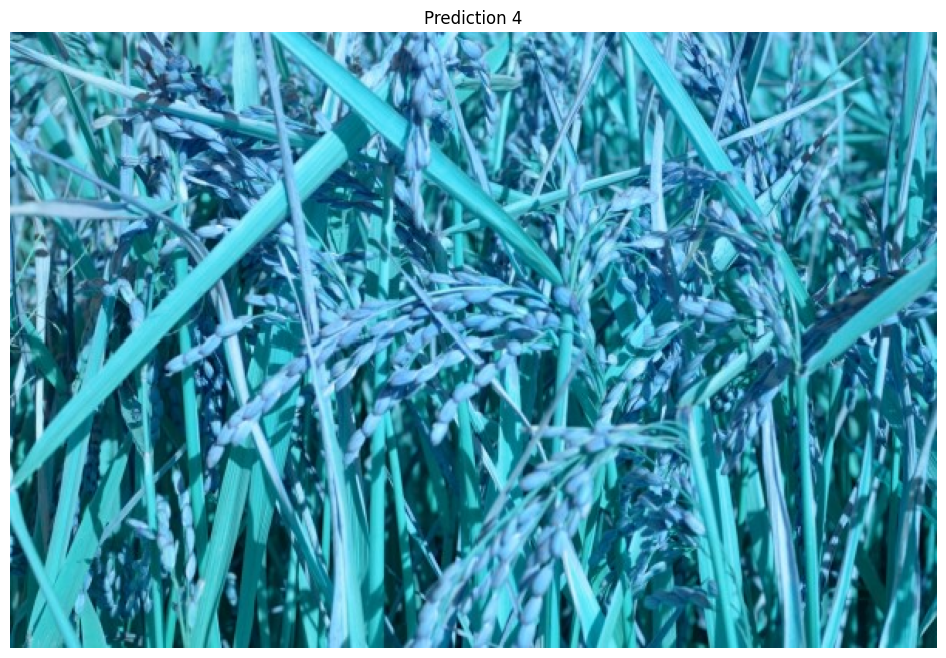

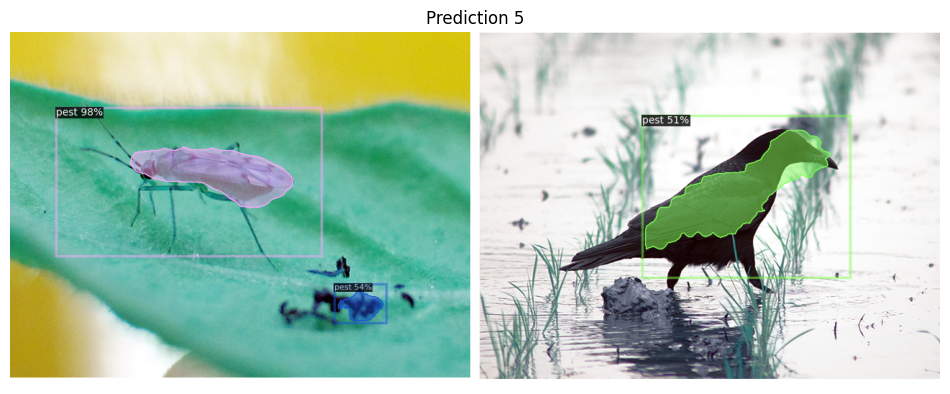

...

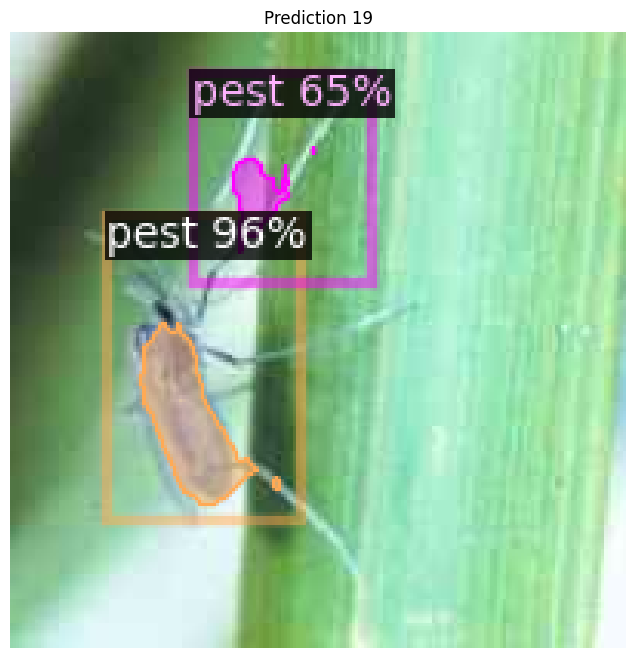

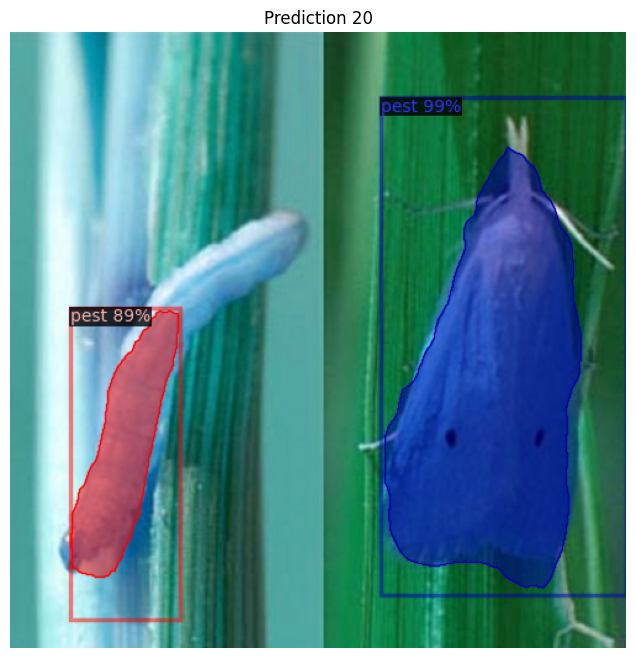

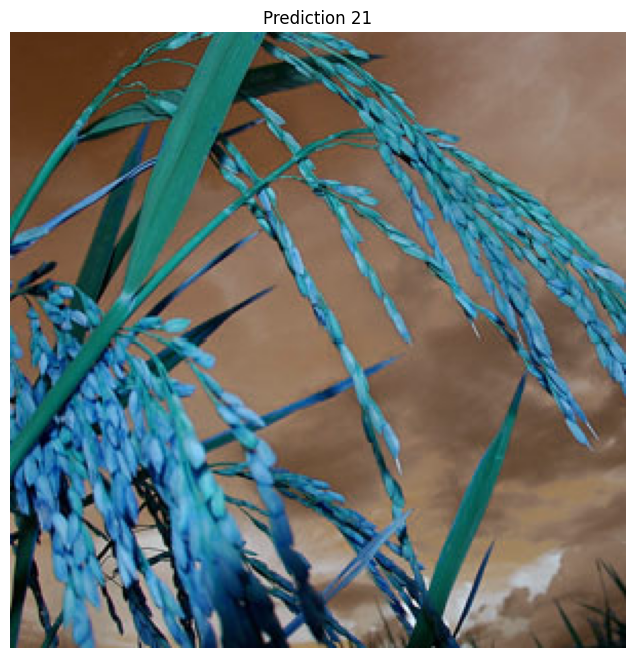

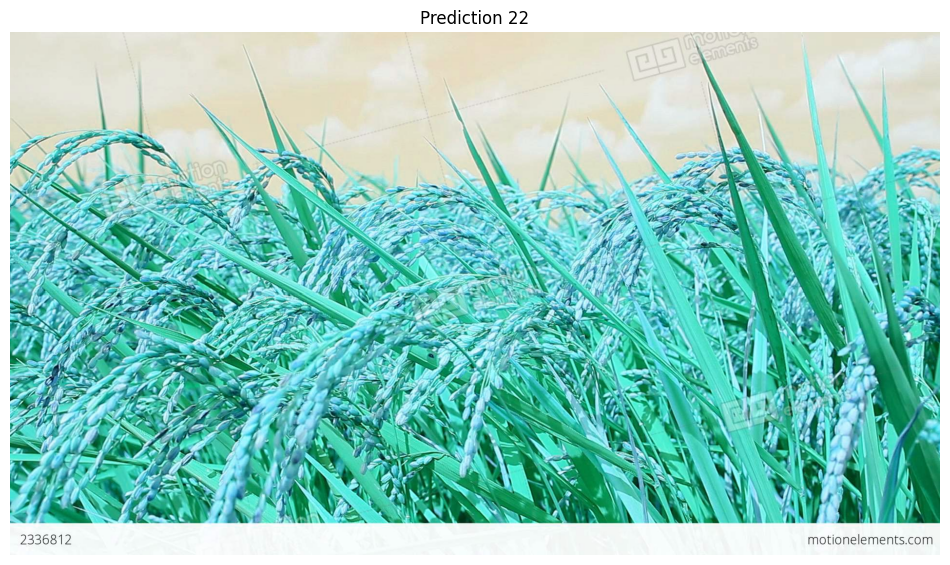

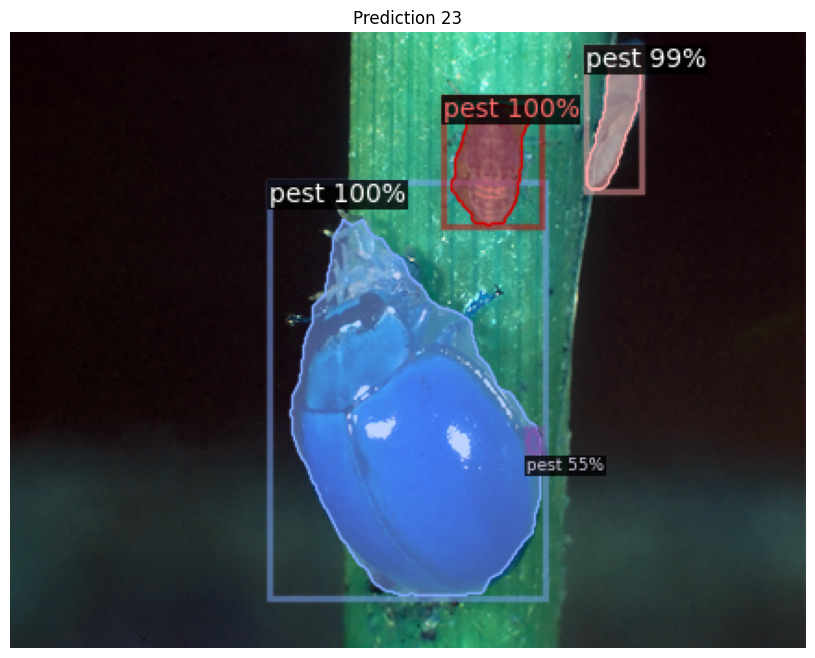

In [ ]:
def display_predictions(cfg, dataset_name, num_samples=5):
    """
    Display predictions on the test dataset interactively.

    Args:
        cfg: Detectron2 config object with the model and dataset settings.
        dataset_name: The name of the dataset (e.g., "paddy_test").
        num_samples: Number of test images to visualize.
    """
    # Load test dataset
    dataset_dicts = DatasetCatalog.get(dataset_name)
    metadata = MetadataCatalog.get(dataset_name)

    # Initialize predictor
    predictor = DefaultPredictor(cfg)

    for i, data in enumerate(dataset_dicts[:num_samples]):
        # Load image
        img = cv2.imread(data["file_name"])

        # Perform prediction
        outputs = predictor(img)

        # Visualize predictions
        v = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.0, instance_mode=ColorMode.IMAGE)
        out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

        # Display image
        plt.figure(figsize=(12, 8))
        plt.imshow(out.get_image()[:, :, ::-1])
        plt.axis("off")
        plt.title(f"Prediction {i + 1}")
        plt.show()

# Example usage
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # Path to the trained model weights
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # Set a confidence threshold for predictions
display_predictions(cfg, "paddy_test", num_samples=25)

In [2]:
import shutil

# Source folder path
source_folder = "/content/finaloutput"

# Destination folder path
destination_folder = "/content/drive/MyDrive/paddy pest detector"

# Move the folder
shutil.move(source_folder, destination_folder)

print(f"Folder moved from {source_folder} to {destination_folder}")

Folder moved from /content/finaloutput to /content/drive/MyDrive/paddy pest detector
